In [1]:
#!pip install folium --user

In [2]:
import json
import folium
from folium import plugins, DivIcon
import requests
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import json_normalize
from geopy.geocoders import Nominatim

Retrieve Massachusetts tax data for 2018 (latest year available)

In [3]:
#df_raw = pd.read_excel('2018 MA Tax Info by Zip.xlsx', header = 5) #https://www.irs.gov/pub/irs-soi/18zp22ma.xlsx
df_raw = pd.read_excel('https://www.irs.gov/pub/irs-soi/18zp22ma.xlsx', header = 5) #https://www.irs.gov/pub/irs-soi/18zp22ma.xlsx

In [4]:
# Make a backup copy for future processing
df = df_raw.copy()
df.head()

,Unnamed: 0,Unnamed: 1,-1,-2,-3,-4,-5,-6,-7,-8,...,-140,-141,-142,-143,-144,-145,-146,-147,-148,-149
0,0,Total,3453140.0,1840970.0,1174200.0,369390.0,3098800.0,204530.0,1889420.0,1934110.0,...,186480.0,1169673.0,778760.0,5349278.0,2582810.0,10389526.0,2490990.0,7015424.0,116630.0,3267032.0
1,0,"$1 under $25,000",979470.0,766720.0,83290.0,114260.0,856740.0,71830.0,484120.0,553900.0,...,0.0,0.0,97740.0,96678.0,799720.0,1322564.0,793710.0,1307311.0,7140.0,11237.0
2,0,"$25,000 under $50,000",749250.0,484900.0,112400.0,132760.0,677070.0,41550.0,384050.0,507460.0,...,0.0,0.0,111110.0,184139.0,633890.0,1505549.0,626850.0,1483347.0,10270.0,20668.0
3,0,"$50,000 under $75,000",503130.0,292860.0,133760.0,61910.0,453860.0,28050.0,272170.0,316150.0,...,0.0,0.0,105030.0,229985.0,396900.0,994464.0,388860.0,963860.0,12230.0,30953.0
4,0,"$75,000 under $100,000",331450.0,138640.0,156200.0,28720.0,298970.0,16470.0,191770.0,194320.0,...,0.0,0.0,83230.0,228400.0,246910.0,749255.0,239020.0,713685.0,9170.0,29646.0


Do some data cleaning

In [5]:
# rename columns
df.rename(columns = {'Unnamed: 0' : 'Zip Code', 'Unnamed: 1' : 'Income Bracket',
                     -18 : 'Number of Returns', -19 : 'Total Income Amount'}, inplace = True)
keepcols = ['Zip Code', 'Income Bracket', 'Number of Returns', 'Total Income Amount']
df = df[keepcols]

# filter to only include top earners
df['Income Bracket'].fillna('', inplace = True)
df = df[df['Income Bracket'].str.contains('200,000')]
df = df[df['Zip Code'].isin([0, 99999]) == False]

# add a 0 to zip codes that were shortened due to integer interpretation
df['Zip Code'] = df['Zip Code'].astype(str)
df['Zip Code'] = df['Zip Code'].apply(lambda x: '0' + x)

In [6]:
# Calculate average income per tax return
df['Number of Returns'] = df['Number of Returns'].astype(int)
df['Total Income Amount'] = df['Total Income Amount'].astype(int)
df['Average Income per Return'] = ((df['Total Income Amount'] / df['Number of Returns']) * 1000)
df = df[df['Average Income per Return'].notnull()]
df['Average Income per Return'] = df['Average Income per Return'].astype(int)

In [7]:
# Group income by zip code
df_zip_income = df.groupby('Zip Code')['Average Income per Return'].mean()
df_zip_income = pd.DataFrame(df_zip_income)
df_zip_income['Average Income per Return'] = df_zip_income['Average Income per Return'].round(0).astype(int)
df_zip_income.reset_index(inplace = True)

Create a map for highest income zip codes in Massachusetts

In [8]:
# Create a Choropleth map for top income zip codes in Massachusetts

total_threshold_scale = [125000,  320000,  515000,  700000,  900000, 1150000]

geojson = requests.get('https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/ma_massachusetts_zip_codes_geo.min.json').json()

avg_map = folium.Map(location = [42.28, -71.60], zoom_start = 8)

avg_map.choropleth(
    geo_data = geojson,
    data = df_zip_income,
    columns = ['Zip Code', 'Average Income per Return'],
    key_on = 'feature.properties.ZCTA5CE10',
    threshold_scale = list(total_threshold_scale),
    fill_color = 'YlOrRd', 
    fill_opacity = 0.5, 
    line_opacity = 0.2,
    legend_name = 'Average Income per Return'
    )

avg_map

/home/wsuser/.local/lib/python3.7/site-packages/folium/folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Find the top ten zip codes for Massachusetts by income

In [9]:
# Get centroid data for Massachusetts zip codes and add to top earnings df

df_zip_income.sort_values('Average Income per Return', ascending = False, inplace = True)
df_top_income = df_zip_income.head(10)
#zip_code_df = pd.read_csv('us-zip-code-latitude-and-longitude.csv', sep = ';') # https://public.opendatasoft.com/explore/dataset/us-zip-code-latitude-and-longitude/download/?format=csv&timezone=America/New_York&lang=en&use_labels_for_header=true&csv_separator=%3B
zip_code_df = pd.read_csv('https://public.opendatasoft.com/explore/dataset/us-zip-code-latitude-and-longitude/download/?format=csv&timezone=America/New_York&lang=en&use_labels_for_header=true&csv_separator=%3B', sep = ';')

zip_code_df.rename(columns = {'Zip' : 'Zip Code'}, inplace = True)
zip_code_df['Zip Code'] = zip_code_df['Zip Code'].astype(str)
zip_code_df['Zip Code'] = zip_code_df['Zip Code'].apply(lambda x: ('0' + x) if len(x) == 4 else x)
df_top_income = pd.merge(left = df_top_income, right = zip_code_df, how = 'left', on = 'Zip Code')

In [10]:
# Generate top income zip codes map, with labels

top_income_map = folium.Map(location = [42.357756, -71.188663], zoom_start = 12)

top_income_map.choropleth(
    geo_data = geojson,
    data = df_top_income,
    columns = ['Zip Code', 'Average Income per Return'],
    key_on = 'feature.properties.ZCTA5CE10',
    threshold_scale = list(total_threshold_scale),
    fill_color = 'YlOrRd', 
    fill_opacity = 0.5, 
    line_opacity = 0.5,
    legend_name = 'Top 10 Average Income'
    )

for lat, lng, zip_code in zip(df_top_income['Latitude'], df_top_income['Longitude'], df_top_income['Zip Code']):
    text = zip_code
    iframe = folium.IFrame(text, width=60, height=35)
    folium.map.Marker(location=[lat,lng],
    icon=DivIcon(
        icon_size=(50,36),
        icon_anchor=(0,0),
        html='<center><b><div style="font-size: 10pt; color: #000000; background-color: #FFFFFF; border: solid 1px black">%s</div></b></center>' % text,
        )
    ).add_to(top_income_map)

top_income_map

Display top ten zip codes by income

In [11]:
# Display top ten zip codes by income
df_top_income.head(10)

,Zip Code,Average Income per Return,City,State,Latitude,Longitude,Timezone,Daylight savings time flag,geopoint
0,02116,1102940,Boston,MA,42.349622,-71.07372,-5,1,"42.349622,-71.07372"
1,02199,1033402,Boston,MA,42.347130,-71.08234,-5,1,"42.34713,-71.08234"
2,02493,986744,Weston,MA,42.358663,-71.28831,-5,1,"42.358663,-71.28831"
3,02110,977870,Boston,MA,42.356532,-71.05365,-5,1,"42.356532,-71.05365"
4,02108,952496,Boston,MA,42.357903,-71.06408,-5,1,"42.357903,-71.06408"
5,02481,759926,Wellesley Hills,MA,42.313329,-71.27649,-5,1,"42.313329,-71.27649"
6,02109,679012,Boston,MA,42.361477,-71.05417,-5,1,"42.361477,-71.05417"
7,02467,624566,Chestnut Hill,MA,42.321997,-71.17314,-5,1,"42.321997,-71.17314"
8,02115,621341,Boston,MA,42.343080,-71.09268,-5,1,"42.34308,-71.09268"
9,02111,598229,Boston,MA,42.349838,-71.06101,-5,1,"42.349838,-71.06101"


Retrieve FourSquare records for butcher shops in each zip code

In [18]:
#remove_cell
CLIENT_ID = '1LR1JASWWSY2DQV3APGJED44SKBECAWZD12LNVVAOOHPH0CS' # your Foursquare ID
CLIENT_SECRET = 'XP3A0XXWFOKI14ZSASVJTOCTTP1I31AOXMUN220MVGIPMOAY' # your Foursquare Secret
VERSION = '20180604'
LIMIT = 250

List all the butcher shops in the queried zip codes

In [13]:
# Build query and retrieve FourSquare records for butcher shops within 5km of the center of each zip code
radius = 5000
categoryId = '4bf58dd8d48988d11d951735' # This is the category for 'Butcher Shops'
all_venues = pd.DataFrame()
for line in df_top_income.index:
    latitude = df_top_income['Latitude'].iloc[line]
    longitude = df_top_income['Longitude'].iloc[line]
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&categoryId={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, radius, categoryId, LIMIT)
    results = requests.get(url).json()
    venues = results['response']['groups'][0]['items']
    nearby_venues = json_normalize(venues) 
    filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
    if 'venue.name' in nearby_venues.columns:
        nearby_venues = nearby_venues.loc[:, filtered_columns]
        nearby_venues['zip.code'] = df_top_income['Zip Code'].iloc[line]
        all_venues = all_venues.append(nearby_venues, ignore_index = True)

all_venues['category.name'] = all_venues['venue.categories'].apply(lambda x: x[0]['name'])
all_venues

,venue.name,venue.categories,venue.location.lat,venue.location.lng,zip.code,category.name
0,The Butcher Shop,"[{'id': '4bf58dd8d48988d155941735', 'name': 'G...",42.344033,-71.071539,02116,Gastropub
1,K & 8th Street Market,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.331396,-71.037248,02116,Butcher
2,Savenor's Market,"[{'id': '4bf58dd8d48988d1f5941735', 'name': 'G...",42.377968,-71.107461,02116,Gourmet Shop
3,Whole Foods Market,"[{'id': '4bf58dd8d48988d118951735', 'name': 'G...",42.345304,-71.063061,02116,Grocery Store
4,Walden Local Butcher Shop,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.342002,-71.070597,02116,Butcher
...,...,...,...,...,...,...
193,Al Bara Market ﺍﻟﻬﺪﻯ,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.372788,-71.098475,02111,Butcher
194,Olde Tyme Butcher,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.324150,-71.097580,02111,Butcher
195,Casa de Carnes Solucao,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.381390,-71.097717,02111,Butcher
196,Stillman's Farm - Cambridgeport Farmers’ Market,"[{'id': '4bf58dd8d48988d11d951735', 'name': 'B...",42.355690,-71.112297,02111,Butcher


Generate a map showing the top income zip codes and butcher shop locations

In [14]:
top_income_map = folium.Map(location = [42.357756, -71.188663], zoom_start = 12)

# Regenerate income map
top_income_map.choropleth(
    geo_data = geojson,
    data = df_top_income,
    columns = ['Zip Code', 'Average Income per Return'],
    key_on = 'feature.properties.ZCTA5CE10',
    threshold_scale = list(total_threshold_scale),
    fill_color = 'YlOrRd', 
    fill_opacity = 0.5, 
    line_opacity = 0.5,
    legend_name = 'Average Income'
    )

# Add markers for zip codes
for lat, lng, zip_code in zip(df_top_income['Latitude'], df_top_income['Longitude'], df_top_income['Zip Code']):
    text = zip_code
    iframe = folium.IFrame(text, width=60, height=35)
    folium.map.Marker(location=[lat,lng],
    icon=DivIcon(
        icon_size=(50,36),
        icon_anchor=(0,0),
        html='<center><b><div style="font-size: 10pt; color: #000000; background-color: #FFFFFF; border: solid 1px black">%s</div></b></center>' % text,
        )
    ).add_to(top_income_map)

# Add markers for butcher shops
for lat, lng, category_name, zip_code in zip(all_venues['venue.location.lat'], all_venues['venue.location.lng'],
                                          all_venues['category.name'], all_venues['zip.code']):
    venue_label = folium.Popup(category_name)
    folium.Marker([lat, lng], popup = venue_label).add_to(top_income_map) 

top_income_map

/home/wsuser/.local/lib/python3.7/site-packages/folium/folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Create a table showing zip codes and the number of servicing butcher shops

In [15]:
# Group venue information by zip code and display servicing venues for each zip code

nearby_venues_chart_df = pd.DataFrame(all_venues.groupby('zip.code')['venue.name'].count())
nearby_venues_chart_df.sort_values('venue.name', inplace = True)
nearby_venues_chart_df.reset_index(drop = False, inplace = True)
nearby_venues_chart_df.rename(columns = {'zip.code' : 'Zip Code', 'venue.name' : 'Venues'}, inplace = True)
nearby_venues_chart_df

,Zip Code,Venues
0,02493,1
1,02481,3
2,02467,10
3,02110,21
4,02109,22
5,02111,23
6,02108,25
7,02116,29
8,02115,32
9,02199,32


Create graphs for servicing venues per zip code, income per zip code, and relationship between income and servicing venues

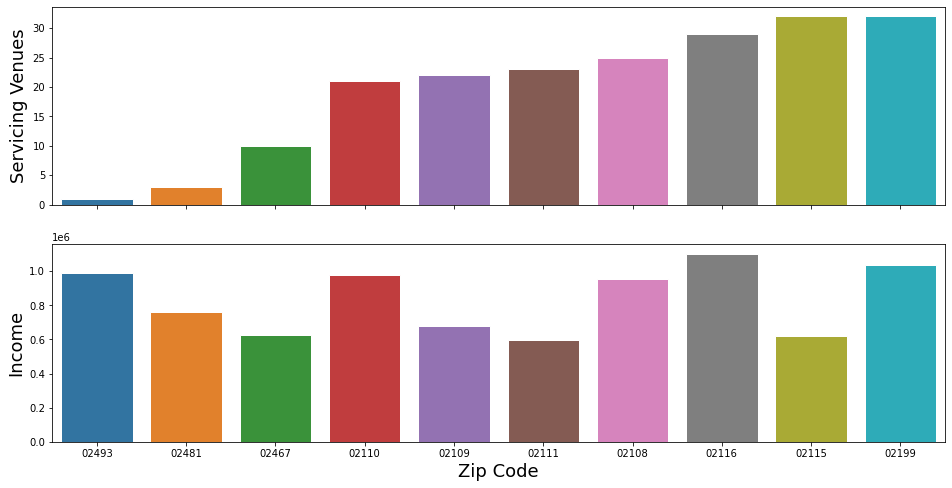

In [16]:
nearby_venues_chart_df.sort_values('Zip Code')
df_top_income.sort_values('Zip Code')

# Create bar charts for servicing venues and income
fig1, (ax1, ax2) = plt.subplots(2, 1, figsize = (16, 8), sharex = True)
sns.set_style('whitegrid')
sns.barplot(x = nearby_venues_chart_df['Zip Code'], y = nearby_venues_chart_df['Venues'], ax = ax1, order = nearby_venues_chart_df['Zip Code'])
ax1.set_xlabel('')
ax1.set_ylabel('Servicing Venues', fontsize = 18)
sns.barplot(x = df_top_income['Zip Code'], y = df_top_income['Average Income per Return'], ax = ax2, order = nearby_venues_chart_df['Zip Code'])
ax2.set_xlabel('Zip Code', fontsize = 18)
ax2.set_ylabel('Income', fontsize = 18)
sns.set_style('whitegrid')

Text(0, 0.5, 'Servicing Venues')

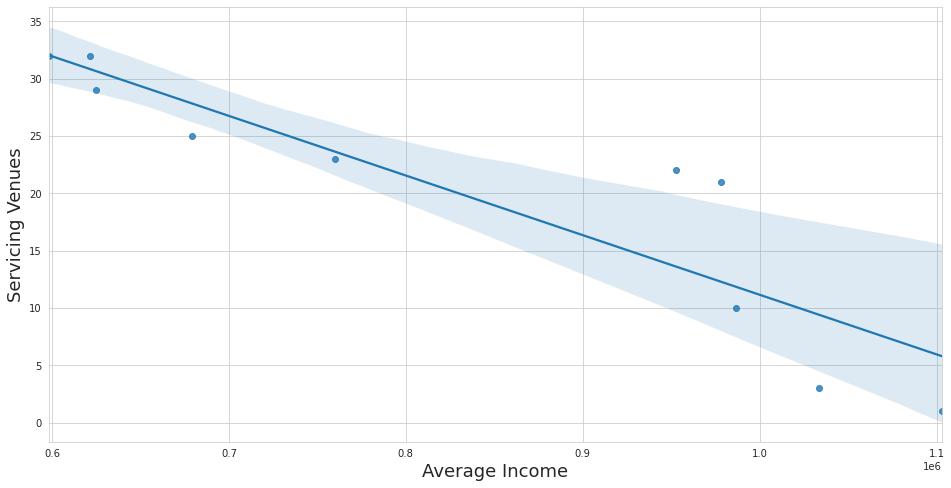

In [17]:
# create line plot for relationship between income and servicing venues
fig2, ax3 = plt.subplots(1, 1, figsize = (16, 8))
sns.regplot(x = df_top_income['Average Income per Return'], y = nearby_venues_chart_df['Venues'], ax = ax3)
ax3.set_xlabel('Average Income', fontsize = 18)
ax3.set_ylabel('Servicing Venues', fontsize = 18)